# **Detectron2 Part-2**

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

**Preparing the dataset.**

In [ ]:
# Mounting Google Drive 
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticating and creating the Drive client
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

**VGG version 2.0**

In [ ]:
df = drive.CreateFile({'id': '17AX6-9of_yUyHtOhmjQ0Ctvh4DnlOXDM'})
df.GetContentFile('road.zip')

In [ ]:
!unzip road.zip > /dev/null

In [ ]:
# Preparing custom dataset
from detectron2.structures import BoxMode

def get_road_dicts(img_dir):
    """This function loads the JSON file created with the annotator and converts it to
    the detectron2 metadata specifications.
    """
    # load the JSON file
    json_file = os.path.join(img_dir, "via_region_data.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    # loop through the entries in the JSON file
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        # add file_name, image_id, height and width information to the records
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]

        objs = []
        # one image can have multiple annotations, therefore this loop is needed
        for annotation in annos:
            # reformat the polygon information to fit the specifications
            anno = annotation["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            region_attributes = annotation["region_attributes"]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
                "iscrowd": 0,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)

    return dataset_dicts

In [ ]:
# Method overriding
for d in ["train", "val"]:
    DatasetCatalog.register("road_" + d, lambda d=d: get_road_dicts("road/" + d))
    MetadataCatalog.get("road_" + d).set(thing_classes=["Defect"])
road_metadata = MetadataCatalog.get("road_train")

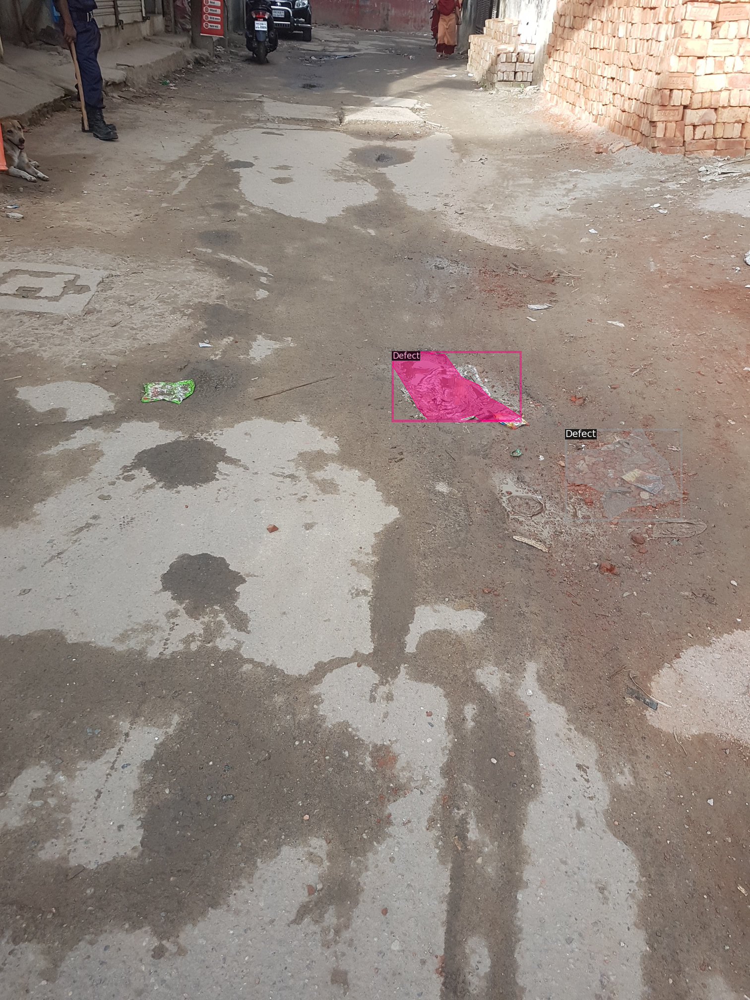

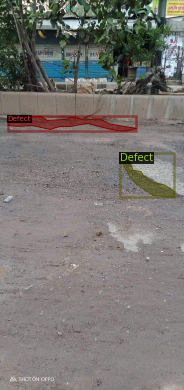

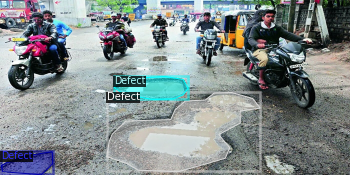

In [ ]:
# Reading 3 random images
dataset_dicts = get_road_dicts("road/train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=road_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

**Starting the Training**

In [ ]:
# Training for batch 32 with ResNet-50-FPN backbone
from detectron2.engine import DefaultTrainer
cfg = get_cfg()
#choose alternative models as backbone here
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("road_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 50000    
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32 # Batch size
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # It only has one class (road)

#The next four lines of code create an output directory, a trainer, and start training.
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[09/21 08:41:38 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:16, 10.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[09/21 08:43:35 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_

[09/21 08:43:45 d2.utils.events]:  eta: 6:35:16  iter: 19  total_loss: 2.329  loss_cls: 0.722  loss_box_reg: 0.490  loss_mask: 0.692  loss_rpn_cls: 0.227  loss_rpn_loc: 0.022  time: 0.4481  data_time: 0.3226  lr: 0.000005  max_mem: 2760M
[09/21 08:43:55 d2.utils.events]:  eta: 6:20:00  iter: 39  total_loss: 2.342  loss_cls: 0.665  loss_box_reg: 0.568  loss_mask: 0.690  loss_rpn_cls: 0.301  loss_rpn_loc: 0.039  time: 0.4670  data_time: 0.3467  lr: 0.000010  max_mem: 2760M
[09/21 08:44:05 d2.utils.events]:  eta: 6:36:16  iter: 59  total_loss: 2.197  loss_cls: 0.603  loss_box_reg: 0.491  loss_mask: 0.685  loss_rpn_cls: 0.227  loss_rpn_loc: 0.047  time: 0.4916  data_time: 0.4010  lr: 0.000015  max_mem: 2760M
[09/21 08:44:14 d2.utils.events]:  eta: 6:36:06  iter: 79  total_loss: 2.158  loss_cls: 0.572  loss_box_reg: 0.667  loss_mask: 0.678  loss_rpn_cls: 0.131  loss_rpn_loc: 0.020  time: 0.4810  data_time: 0.3077  lr: 0.000020  max_mem: 2760M
[09/21 08:44:24 d2.utils.events]:  eta: 6:47:59 

In [ ]:
# Displaying the training results in the graphs.
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
# cfg already contains everything we've set previously. Now we changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

In [ ]:
# Inference on the validation set
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_road_dicts("road/val")
for d in random.sample(dataset_dicts, 40):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=road_metadata, 
                   scale=0.5, 
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Calculating the AP matrix
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("road_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "road_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use "trainer.test"

**Another Training**

In [ ]:
# Training for batch 512 with ResNet-50-FPN backbone
from detectron2.engine import DefaultTrainer
cfg = get_cfg()
#choose alternative models as backbone here
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("road_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 50000    
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512 # Batch size
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # It only has one class (road)

#The next four lines of code create an output directory, a trainer, and start training.
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[09/23 06:14:31 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:27, 6.52MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[09/23 06:16:28 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_

[09/23 06:16:37 d2.utils.events]:  eta: 4:46:21  iter: 19  total_loss: 1.699  loss_cls: 0.632  loss_box_reg: 0.061  loss_mask: 0.691  loss_rpn_cls: 0.256  loss_rpn_loc: 0.036  time: 0.4270  data_time: 0.2080  lr: 0.000005  max_mem: 2763M
[09/23 06:16:46 d2.utils.events]:  eta: 4:46:49  iter: 39  total_loss: 1.499  loss_cls: 0.550  loss_box_reg: 0.034  loss_mask: 0.689  loss_rpn_cls: 0.205  loss_rpn_loc: 0.032  time: 0.4336  data_time: 0.1981  lr: 0.000010  max_mem: 2763M
[09/23 06:16:54 d2.utils.events]:  eta: 4:46:00  iter: 59  total_loss: 1.423  loss_cls: 0.431  loss_box_reg: 0.047  loss_mask: 0.685  loss_rpn_cls: 0.238  loss_rpn_loc: 0.028  time: 0.4267  data_time: 0.1397  lr: 0.000015  max_mem: 2763M
[09/23 06:17:04 d2.utils.events]:  eta: 4:50:32  iter: 79  total_loss: 1.249  loss_cls: 0.340  loss_box_reg: 0.065  loss_mask: 0.676  loss_rpn_cls: 0.119  loss_rpn_loc: 0.020  time: 0.4471  data_time: 0.2876  lr: 0.000020  max_mem: 2763M
[09/23 06:17:13 d2.utils.events]:  eta: 4:56:17 

In [ ]:
# Displaying the training results in the graphs.
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
# cfg already contains everything we've set previously. Now we changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

In [ ]:
# Inference on the validation set
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_road_dicts("road/val")
for d in random.sample(dataset_dicts, 40):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=road_metadata, 
                   scale=0.5, 
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Calculating the AP matrix
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("road_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "road_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use "trainer.test"

[09/23 12:42:14 d2.data.common]: Serializing 41 elements to byte tensors and concatenating them all ...
[09/23 12:42:14 d2.data.common]: Serialized dataset takes 0.06 MiB
[09/23 12:42:14 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/23 12:42:14 d2.evaluation.evaluator]: Start inference on 41 images
[09/23 12:42:15 d2.evaluation.evaluator]: Inference done 11/41. 0.0704 s / img. ETA=0:00:02
[09/23 12:42:18 d2.evaluation.evaluator]: Total inference time: 0:00:03.271375 (0.090872 s / img per device, on 1 devices)
[09/23 12:42:18 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:02 (0.070082 s / img per device, on 1 devices)
[09/23 12:42:18 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/23 12:42:18 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[09/23 12:42:18 d2.evaluation.coco_evaluation]: Evaluating pred